# AutoEncoder_MobileNet

this notebook has been used to train the unsupervised part of the project

In [51]:
#for google collab
#!pip install -q git+https://github.com/tensorflow/docs
#!pip install umap-learn
import os
import cv2

import math
import random
import numpy as np
import datetime as dt
import tensorflow as tf
from collections import deque
import matplotlib.pyplot as plt
 
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import *
from tensorflow.keras.models import Sequential
from tensorflow.keras import Model
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model
from tensorflow.keras.applications import MobileNet
from keras.applications.mobilenet import preprocess_input
import umap

import imageio
from tensorflow_docs.vis import embed

In [96]:
# Specify the height and width to which each video frame will be resized in our dataset.
IMAGE_HEIGHT , IMAGE_WIDTH = 224, 224
 
# Specify the number of frames of a video that will be fed to the model as one sequence.
SEQUENCE_LENGTH = 5
 
# Specify the directory containing the UCSD dataset. 
#DATASET_DIR = "UCSD_ANOMALY"
CLASSES_LIST = ["Train", "Test"]

# for preprocessed video
DATASET_DIR = "UCSD_ANOMALY_Preprocessed"
CLASSES_LIST = ["Train_opticalFlowFarneback", "Test_opticalFlowFarneback"]
#CLASSES_LIST = ["Train_opticalFlowSimple", "Test_opticalFlowSimple"]

In [97]:
def normalizeMobile(img):
    return (img / 127.5) - 1

def unnormalizeMobile(img):
    return ((img + 1.) * 127.5).astype(np.uint8)

In [98]:
def normalize(img):
    return img / 255.

def unnormalize(img):
    return (img * 255.).astype(np.uint8)

In [99]:
def frames_extraction(video_path):
    '''
    This function will extract the required frames from a video after resizing and normalizing them.
    Args:
        video_path: The path of the video in the disk, whose frames are to be extracted.
    Returns:
        frames_list: A list containing the resized and normalized frames of the video.
    '''
    # Read the Video File using the VideoCapture object.
    video_reader = cv2.VideoCapture(video_path)

    # Get the total number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))

    # Calculate the the interval after which frames will be added to the list.
    #skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)

    # Iterate through the Video Frames.
    frames_list = []
    for frame_counter in range(video_frames_count):

        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter)

        # Reading the frame from the video. 
        success, frame = video_reader.read() 

        # Check if Video frame is not successfully read then break the loop
        if not success:
            break

        # Normalize the resized frame by dividing it with 255 so that each pixel value then lies between 0 and 1
        #normalized_frame = normalizeMobile(frame)
        normalized_frame = normalize(frame)

        
        # Append the normalized frame into the frames list
        frames_list.append(normalized_frame)
    
    # Release the VideoCapture object. 
    video_reader.release()

    frames_list = np.array(frames_list)

    # Return the frames list.
    return frames_list

In [106]:
def create_dataset():
    '''
    This function will extract the data of the selected classes and create the required dataset.
    Returns:
        features:          A list containing the extracted frames of the videos.
        labels:            A list containing the indexes of the classes associated with the videos.
        video_files_paths: A list containing the paths of the videos in the disk.
    '''

    # Declared Empty Lists to store the features, labels and video file path values.
    features = []
    labels = []
    video_files_paths = []
    
    # Iterating through all the classes mentioned in the classes list
    for class_index, class_name in enumerate(CLASSES_LIST):
        
        # Display the name of the class whose data is being extracted.
        print(f'Extracting Data of Class: {class_name}')
        
        # Get the list of video files present in the specific class name directory.
        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))
        
        # Iterate through all the files present in the files list.
        for file_name in files_list:
            
            # Get the complete video path.
            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)
                # Append the data to their repective lists.
            features.append(video_file_path)
            labels.append(class_index)


    # Converting the list to numpy arrays
    features = np.asarray(features)
    labels = np.array(labels)  
    
    # Return the frames, class index, and video file path.
    return features, labels, video_files_paths

In [107]:
# Create the dataset.
features, labels, video_files_paths = create_dataset()

Extracting Data of Class: Train_opticalFlowFarneback
Extracting Data of Class: Test_opticalFlowFarneback


In [108]:
# Using Keras's to_categorical method to convert labels into one-hot-encoded vectors
one_hot_encoded_labels = to_categorical(labels)
features.shape

(70,)

In [109]:
# Split the Data into Train ( 75% ) and Test Set ( 25% ).
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.25, shuffle = True)

In [110]:
labels_train = labels_train[:,0]
labels_test = labels_test[:,0]

In [111]:
labels_train

array([1., 0., 1., 0., 1., 0., 0., 0., 1., 1., 0., 1., 0., 1., 1., 1., 1.,
       1., 0., 1., 0., 0., 0., 1., 1., 1., 0., 1., 0., 1., 1., 0., 1., 0.,
       1., 0., 0., 0., 0., 1., 1., 1., 1., 0., 0., 0., 1., 0., 0., 1., 1.,
       1.], dtype=float32)

In [112]:
features_train_ras = features_train[labels_train==1]
features_train_suspect = features_train[labels_train==0]
 


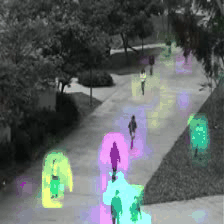

In [113]:
x = unnormalize(frames_extraction(features_train_ras[0]))
imageio.mimsave("animation_real.gif",x , fps=15)
embed.embed_file("animation_real.gif")


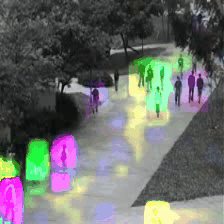

In [114]:
x = unnormalize(frames_extraction(features_train_suspect[0]))
imageio.mimsave("animation_real.gif",x , fps=15)
embed.embed_file("animation_real.gif")

In [115]:
X = []
Y = []
for vid in features_train_ras:
    full_vid = frames_extraction(vid)
    random.shuffle(full_vid)
    for frame in full_vid[:10]:
        X.append(frame)
        Y.append(frame)
X = np.array(X)
Y = np.array(Y)


# Load the model

In [116]:
model = tf.keras.models.load_model("Weights/basic_autoencoder.h5")
#model = tf.keras.models.load_model("Weights/mobil_autoencoder.h5")
#for layer in model.layers[0].layers[:85]:
#    layer.trainable = True

model.compile(optimizer='adam',loss='mse',metrics=['mse'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 46, 46, 32)        57688     
                                                                 
 sequential_2 (Sequential)   (None, 224, 224, 3)       57771     
                                                                 
Total params: 115,459
Trainable params: 115,459
Non-trainable params: 0
_________________________________________________________________


In [117]:
epochs = 30
BATCH_SIZE=10


history =  model.fit(X, Y, epochs=epochs, batch_size=BATCH_SIZE, validation_split=0.2)

Epoch 1/30
23/23 [==============================] - 3s 85ms/step - loss: 0.1591 - mse: 0.1591 - val_loss: 0.1591 - val_mse: 0.1591
Epoch 2/30
23/23 [==============================] - 1s 53ms/step - loss: 0.1205 - mse: 0.1205 - val_loss: 0.1310 - val_mse: 0.1310
Epoch 3/30
23/23 [==============================] - 1s 53ms/step - loss: 0.0959 - mse: 0.0959 - val_loss: 0.1053 - val_mse: 0.1053
Epoch 4/30
23/23 [==============================] - 1s 53ms/step - loss: 0.0747 - mse: 0.0747 - val_loss: 0.0852 - val_mse: 0.0852
Epoch 5/30
23/23 [==============================] - 1s 53ms/step - loss: 0.0560 - mse: 0.0560 - val_loss: 0.0573 - val_mse: 0.0573
Epoch 6/30
23/23 [==============================] - 1s 53ms/step - loss: 0.0414 - mse: 0.0414 - val_loss: 0.0517 - val_mse: 0.0517
Epoch 7/30
23/23 [==============================] - 1s 53ms/step - loss: 0.0337 - mse: 0.0337 - val_loss: 0.0505 - val_mse: 0.0505
Epoch 8/30
23/23 [==============================] - 1s 53ms/step - loss: 0.0305 - m

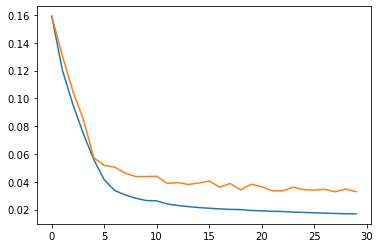

In [118]:
plt.plot(history.history["loss"])
plt.plot(history.history["val_loss"])

# Evaluation of the residual image

In [119]:
from sklearn.metrics import mean_absolute_error

(60, 224, 224, 3)


{'whiskers': [<matplotlib.lines.Line2D at 0x7f08512e91f0>,
 'caps': [<matplotlib.lines.Line2D at 0x7f08512e9790>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f08512dbee0>],
 'medians': [<matplotlib.lines.Line2D at 0x7f08512e9d30>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f08512f4040>],
 'means': []}

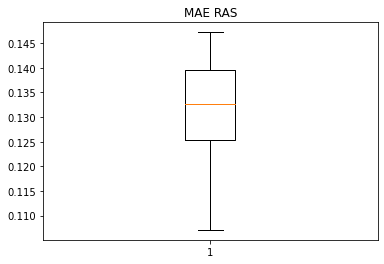

In [120]:
features_test_ras = features_test[labels_test==1]

X_test = []
Y_test = []

for vid in features_test_ras:
    full_vid = frames_extraction(vid)
    random.shuffle(full_vid)
    for frame in full_vid[:10]:
        X_test.append(frame)
        Y_test.append(frame)

X_test = np.array(X_test)
Y_test = np.array(Y_test)
        
print(X_test.shape)

Y_pred = model.predict(X_test)

MAE = np.zeros(Y_test.shape[0])
for i in range(Y_test.shape[0]):
  MAE[i] = mean_absolute_error(Y_test[i].flatten(), Y_pred[i].flatten())
plt.title("MAE RAS")
plt.boxplot(MAE)


{'whiskers': [<matplotlib.lines.Line2D at 0x7f0851242970>,
 'caps': [<matplotlib.lines.Line2D at 0x7f0851242f10>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f08512426a0>],
 'medians': [<matplotlib.lines.Line2D at 0x7f085124f4f0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f085124f7c0>],
 'means': []}

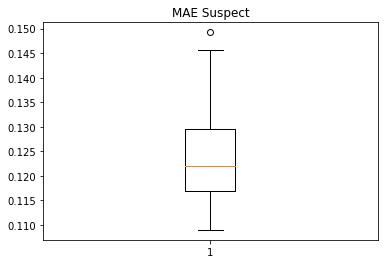

In [121]:
features_test_suspect = features_test[labels_test==0]

X_test = []
Y_test = []

for vid in features_test_suspect:
    full_vid = frames_extraction(vid)
    random.shuffle(full_vid)
    for frame in full_vid[:10]:
        X_test.append(frame)
        Y_test.append(frame)

X_test = np.array(X_test)
Y_test = np.array(Y_test)
     
Y_pred = model.predict(X_test)

MAE = np.zeros(Y_test.shape[0])
for i in range(Y_test.shape[0]):
  MAE[i] = mean_absolute_error(Y_test[i].flatten(), Y_pred[i].flatten())
plt.title("MAE Suspect")
plt.boxplot(MAE)


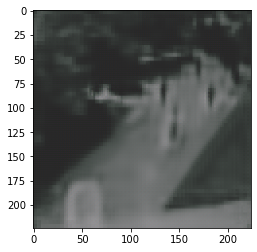

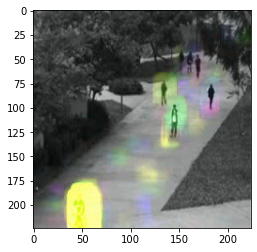

In [122]:
plt.imshow(Y_pred[9])
plt.show()
plt.imshow(Y_test[9])


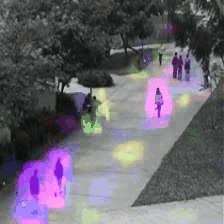

In [123]:
x = unnormalize(frames_extraction(features_test_suspect[1]))
imageio.mimsave("animation_real.gif",x , fps=15)
embed.embed_file("animation_real.gif")


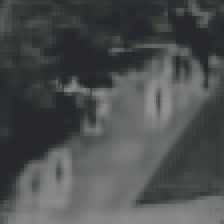

In [124]:
full_vid = frames_extraction(features_test_suspect[1])
Y_pred = model.predict(full_vid)
imageio.mimsave("animation_real.gif",unnormalize(Y_pred) , fps=15)
embed.embed_file("animation_real.gif")

In [125]:

X_test = []
Y_test = []
label_test = []

X_test = []
Y_test = []

for vid in features_test_ras:
    full_vid = frames_extraction(vid)
    random.shuffle(full_vid)
    for frame in full_vid[:10]:
        X_test.append(frame)
        Y_test.append(frame)
        label_test.append(0)
        
for vid in features_test_suspect:
    full_vid = frames_extraction(vid)
    random.shuffle(full_vid)
    for frame in full_vid[:10]:
        X_test.append(frame)
        Y_test.append(frame)
        label_test.append(1)

X_test = np.array(X_test)
Y_test = np.array(Y_test)
label_test = np.array(label_test)

In [126]:
encoder_pred = model.layers[0].predict(X_test)

In [127]:
encoder_pred.shape

(180, 46, 46, 32)

In [128]:
encoder_pred = encoder_pred.reshape([encoder_pred.shape[0],
                                     encoder_pred.shape[1]*
                                     encoder_pred.shape[2]*
                                     encoder_pred.shape[3]])

In [129]:
encoder_pred.shape

(180, 67712)

In [130]:
reducer = umap.UMAP(n_components=2)
reduced_result = reducer.fit_transform(encoder_pred)

In [131]:
reduced_result[label_test==0].shape

(60, 2)

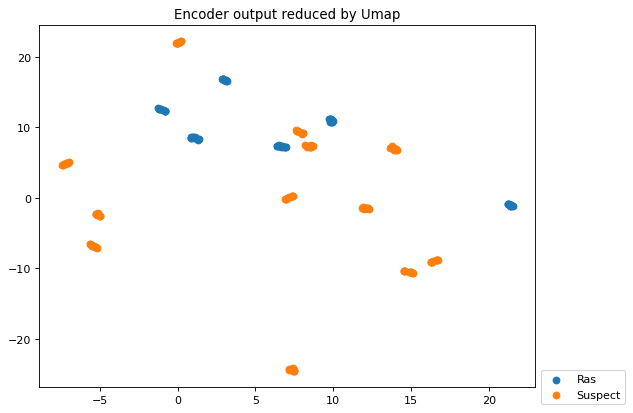

In [132]:
from matplotlib.pyplot import figure

figure(figsize=(8, 6), dpi=80)
plt.title("Encoder output reduced by Umap")

plt.scatter(reduced_result[label_test==0][:,0],reduced_result[label_test==0][:,1], label='Ras')
plt.scatter(reduced_result[label_test==1][:,0],reduced_result[label_test==1][:,1], label='Suspect')
plt.legend(loc='center left', bbox_to_anchor=(1, 0))

# Unsupervised anomally detection

This algorithm apply a centroid to moving data. each frame after has been feed to the encoder part is place on the space and can make move the centroid.

In [133]:
class MovingKmeans:
    def initializ_centroids(self, X):
            np.random.RandomState(123)
            random_idx = np.random.permutation(X.shape[0])
            self.centroid = X[random_idx[0]]

    def compute_sse(self, X):
        distance = np.zeros(X.shape[0])
        distance = np.linalg.norm(X - self.centroid, axis=1)
        return np.sum(np.square(distance))
    
    def compute_centroid_move(self, X):
        X = np.append(X, [self.centroid],axis=0)
        self.centroid = np.zeros(X.shape[1])
        self.centroid = np.mean(X, axis=0)
        
    def compute_centroid(self, X):
        self.centroid = np.zeros(X.shape[1])
        self.centroid = np.mean(X, axis=0)
        
    def fit(self, X, epochs):
        self.lastSample = X[-3:]
        self.initializ_centroids(X)
        for i in range(epochs):
            self.compute_centroid(X)
            self.error = self.compute_sse(X)
        
    def move(self, x):
        self.lastSample = np.roll(self.lastSample, 1)
        self.lastSample[0] = x
        error = self.compute_sse(self.lastSample)
        self.compute_centroid_move(self.lastSample)
        
        return error
        

# test of the implementation

(10, 2)


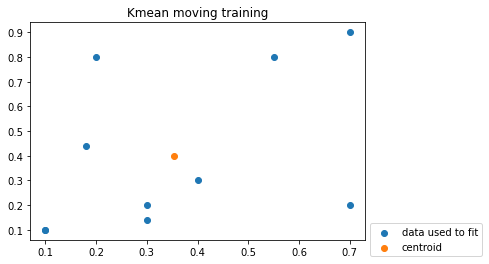

In [134]:
# unit test

dataTofit = np.array([[0.1,0.1],
                     [0.3,0.14],
                     [0.2,0.8],
                     [0.55,0.8],
                     [0.7,0.2],
                     [0.7,0.9],
                     [0.18,0.44],
                     [0.4,0.3],
                     [0.3,0.2],
                     [0.1,0.1]])
print(dataTofit.shape)
plt.title("Kmean moving training")
plt.scatter(dataTofit[:,0],dataTofit[:,1], label='data used to fit')

mkm = MovingKmeans()
mkm.fit(dataTofit, 10)
basecentroid = mkm.centroid
plt.scatter(basecentroid[0],basecentroid[1], label='centroid')
plt.legend(loc='center left', bbox_to_anchor=(1, 0))

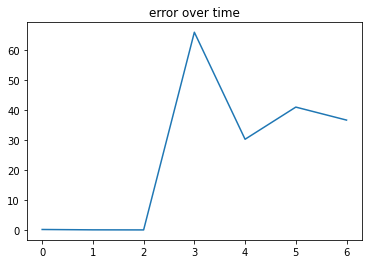

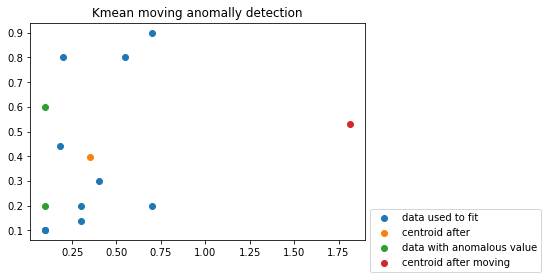

In [135]:
dataWithAnomally = np.array([[0.1,0.1],
                            [0.6,0.2],
                            [0.6,0.1],
                            [6,6],
                            [0.3,0.1],
                            [0.3,0.22],
                            [0.4,0.2]])

error = []
for sample in dataWithAnomally:
    error.append(mkm.move(sample))

plt.title("error over time")
plt.plot(error)
plt.show()
    
plt.title("Kmean moving anomally detection")  
plt.scatter(dataTofit[:,0],dataTofit[:,1], label='data used to fit')
plt.scatter(basecentroid[0],basecentroid[1], label='centroid after')
plt.scatter(dataWithAnomally[0],dataWithAnomally[1], label='data with anomalous value')  
plt.scatter(mkm.centroid[0],mkm.centroid[1], label='centroid after moving')
plt.legend(loc='center left', bbox_to_anchor=(1, 0))

# Test on a video with an anomally

In [136]:
X_test = []
Y_test = []
label_test = []

X_test = []
Y_test = []


full_vid = frames_extraction(features_test_ras[0])
for frame in full_vid:
    X_test.append(frame)
    Y_test.append(frame)
    label_test.append(0)
        

full_vid = frames_extraction(features_test_suspect[1])
for frame in full_vid:
    X_test.append(frame)
    Y_test.append(frame)
    label_test.append(1)

X_test = np.array(X_test)
Y_test = np.array(Y_test)
label_test = np.array(label_test)

In [137]:
encoder_pred = model.layers[0].predict(X_test)
encoder_pred = encoder_pred.reshape([encoder_pred.shape[0],
                                     encoder_pred.shape[1]*
                                     encoder_pred.shape[2]*
                                     encoder_pred.shape[3]])

In [138]:
encoder_pred.shape

(398, 67712)

In [139]:
train_sample = encoder_pred[label_test==1]
test_sample = encoder_pred[label_test==0]
mkm = MovingKmeans()
mkm.fit(train_sample[:100], 3)

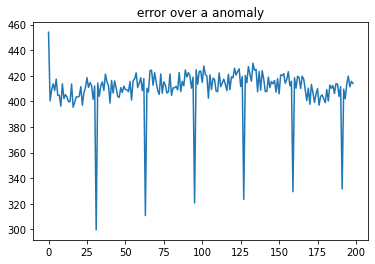

In [140]:
error = []
for sample in test_sample:
    error.append(mkm.move(sample))
plt.title("error over a anomaly")
plt.plot(error)
plt.show()